In [14]:
import pandas as pd
import numpy as np
import random, os
import plotly.express as px
import plotly.graph_objects as go

import tqdm
from datetime import datetime

In [2]:
random_state = 42
os.environ['PYTHONHASHSEED'] = str(random_state)
random.seed(random_state)
np.random.seed(random_state)


In [3]:
os.getcwd()

'/Users/3ign0n/workspace/data-science/SIGNATE/SIGNATE_Career_Up_Challenge_2023/scuc23/notebooks'

In [4]:
%cd ..
%pwd

/Users/3ign0n/workspace/data-science/SIGNATE/SIGNATE_Career_Up_Challenge_2023/scuc23


'/Users/3ign0n/workspace/data-science/SIGNATE/SIGNATE_Career_Up_Challenge_2023/scuc23'

In [5]:
df0 = pd.read_csv('data/01_raw/train.csv')
df0

,id,region,year,manufacturer,condition,cylinders,fuel,odometer,title_status,transmission,drive,size,type,paint_color,state,price
0,0,nashville,1949,bmw,excellent,6 cylinders,gas,115148,clean,manual,rwd,mid-size,convertible,orange,NaN,27587
1,1,state college,2013,toyota,fair,8 cylinders,gas,172038,clean,automatic,rwd,full-size,sedan,silver,pa,4724
2,2,wichita,1998,ford,good,6 cylinders,gas,152492,clean,automatic,fwd,full-size,SUV,silver,ks,10931
3,3,albany,2014,ford,excellent,4 cylinders,gas,104118,clean,manual,fwd,mid-size,SUV,blue,ny,16553
4,4,redding,2005,ford,excellent,6 cylinders,gas,144554,clean,manual,fwd,mid-size,sedan,red,ca,5158
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
27527,27527,williamsport,2008,ford,good,6 cylinders,gas,26660,clean,automatic,rwd,compact,truck,black,pa,32212
27528,27528,tulsa,2007,ford,excellent,8 cylinders,gas,108072,clean,automatic,rwd,full-size,pickup,black,NaN,5400
27529,27529,rochester,2019,jeep,like new,6 cylinders,gas,139908,clean,automatic,4wd,mid-size,SUV,white,ny,22227
27530,27530,rochester,2007,jeep,excellent,6 cylinders,gas,112326,clean,automatic,4wd,mid-size,sedan,white,ny,3054


In [6]:
df1 = pd.read_csv('data/01_raw/test.csv')
df1

,id,region,year,manufacturer,condition,cylinders,fuel,odometer,title_status,transmission,drive,size,type,paint_color,state
0,27532,western slope,2015,chevrolet,excellent,4 cylinders,gas,92553,clean,automatic,fwd,full-size,SUV,red,NaN
1,27533,roseburg,2013,nissan,like new,4 cylinders,gas,134385,salvage,automatic,fwd,mid-size,sedan,black,or
2,27534,akron / canton,2011,volkswagen,good,4 cylinders,gas,102489,clean,automatic,fwd,full-size,sedan,black,oh
3,27535,denver,2016,jeep,excellent,6 cylinders,diesel,64310,clean,automatic,4wd,mid-size,SUV,red,co
4,27536,hickory / lenoir,1999,honda,excellent,8 cylinders,gas,180839,rebuilt,automatic,4wd,mid-size,SUV,silver,nc
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
27532,55064,great falls,2016,gmc,excellent,6 cylinders,gas,90902,rebuilt,automatic,fwd,full-size,truck,black,mt
27533,55065,las vegas,2012,nissan,excellent,4 cylinders,gas,27234,rebuilt,automatic,fwd,mid-size,sedan,white,nv
27534,55066,phoenix,2002,bmw,excellent,6 cylinders,gas,99761,clean,automatic,rwd,full-size,coupe,blue,az
27535,55067,colorado springs,2006,bmw,excellent,6 cylinders,gas,162279,clean,automatic,4wd,mid-size,sedan,silver,co


In [7]:
df_region_state = pd.read_csv('data/01_raw/region-state.csv')
df_region_state

,region,state
0,nashville,tn
1,rockford,il
2,san antonio,tx
3,flagstaff / sedona,az
4,las vegas,nv
...,...,...
342,glens falls,ny
343,olympic peninsula,wa
344,southeast KS,ks
345,janesville,wi


In [69]:
def __preprocess_column_region_state(data: pd.DataFrame, region_state_data: pd.DataFrame) -> pd.DataFrame:
    tmp_df = pd.merge(data, region_state_data, on='region', how='left')
    tmp_df['state']=tmp_df['state_x'].fillna(tmp_df['state_y'])
    tmp_df = tmp_df.drop(columns=['state_x', 'state_y'])
    return tmp_df

def __preprocess_column_year(data: pd.DataFrame) -> pd.DataFrame:
    # 2999年以上の値はおかしいので、入力ミスと考え、-1000する
    data.loc[data['year']>=2999, 'year'] = data['year'] - 1000
    return data

def __preprocess_column_manufacturer(data: pd.DataFrame) -> pd.DataFrame:
    data['manufacturer'] = data['manufacturer'].str.lower()
    data['manufacturer'] = data['manufacturer'].str.normalize('NFKC')
    
    # nissanにunicodeの変な文字が混じっていた
    data['manufacturer'] = data['manufacturer'].str.replace(u"\u0455", 's')
    # toyotaにunicodeの変な文字が混じっていた
    data['manufacturer'] = data['manufacturer'].str.replace(u"\u0430", 'a')
    # subaru, saturnにunicodeの変な文字が混じっていた
    data['manufacturer'] = data['manufacturer'].str.replace(u"\u03b1", 'a')
    # volkswagenにunicodeの変な文字が混じっていた
    data['manufacturer'] = data['manufacturer'].str.replace(u"\u043e", 'o')
    # chryslerにunicodeの変な文字が混じっていた
    data['manufacturer'] = data['manufacturer'].str.replace(u"\u1d04", 'c')
    return data


def __preprocess_column_odometer(data: pd.DataFrame) -> pd.DataFrame:
    # オドメーターが負数というのはおかしいので、入力ミスと考え、正数に直す
    data.loc[data['odometer']<0, 'odometer'] = data['odometer'] * -1
    
    # 10万キロ超えたら買い替え検討、２０万キロ超えたらだいぶやばいと言われているのに走行距離50万キロ超えは明らかな入力ミスと考え、一桁減らす
    data.loc[data['odometer']>500000, 'odometer'] = data['odometer'] / 10
    return data


def __preprocess_column_size(data: pd.DataFrame) -> pd.DataFrame:
    data['size'] = data['size'].str.replace('ー', '-')
    data['size'] = data['size'].str.replace('−', '-')    
    return data


def __apply_preprocessing_rules(data: pd.DataFrame, region_state_data: pd.DataFrame) -> pd.DataFrame:
    tmp_df = __preprocess_column_region_state(data, region_state_data)
    tmp_df = __preprocess_column_year(tmp_df)
    tmp_df = __preprocess_column_manufacturer(tmp_df)
    tmp_df = __preprocess_column_odometer(tmp_df)
    return __preprocess_column_size(tmp_df)


df_train = __apply_preprocessing_rules(df0, df_region_state)
df_test = __apply_preprocessing_rules(df0, df_region_state)

In [49]:
manufacturer=df_train["manufacturer"].unique()
manufacturer.sort()
manufacturer

array(['acura', 'alfa-romeo', 'aston-martin', 'audi', 'bmw', 'buick',
       'cadillac', 'chevrolet', 'chrysler', 'dodge', 'fiat', 'ford',
       'gmc', 'honda', 'hyundai', 'infiniti', 'jaguar', 'jeep', 'kia',
       'land rover', 'lexus', 'lincoln', 'mazda', 'mercedes-benz',
       'mercury', 'mini', 'mitsubishi', 'nissan', 'pontiac', 'porsche',
       'ram', 'rover', 'saturn', 'subaru', 'toyota', 'volkswagen',
       'volvo'], dtype=object)

In [50]:
manufacturer=df_test["manufacturer"].unique()
manufacturer.sort()
manufacturer

array(['acura', 'alfa-romeo', 'aston-martin', 'audi', 'bmw', 'buick',
       'cadillac', 'chevrolet', 'chrysler', 'dodge', 'fiat', 'ford',
       'gmc', 'honda', 'hyundai', 'infiniti', 'jaguar', 'jeep', 'kia',
       'land rover', 'lexus', 'lincoln', 'mazda', 'mercedes-benz',
       'mercury', 'mini', 'mitsubishi', 'nissan', 'pontiac', 'porsche',
       'ram', 'rover', 'saturn', 'subaru', 'toyota', 'volkswagen',
       'volvo'], dtype=object)

In [51]:
df_train

,id,region,year,manufacturer,condition,cylinders,fuel,odometer,title_status,transmission,drive,size,type,paint_color,price,state
0,0,nashville,1949,bmw,excellent,6 cylinders,gas,115148,clean,manual,rwd,mid-size,convertible,orange,27587,tn
1,1,state college,2013,toyota,fair,8 cylinders,gas,172038,clean,automatic,rwd,full-size,sedan,silver,4724,pa
2,2,wichita,1998,ford,good,6 cylinders,gas,152492,clean,automatic,fwd,full-size,SUV,silver,10931,ks
3,3,albany,2014,ford,excellent,4 cylinders,gas,104118,clean,manual,fwd,mid-size,SUV,blue,16553,ny
4,4,redding,2005,ford,excellent,6 cylinders,gas,144554,clean,manual,fwd,mid-size,sedan,red,5158,ca
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
27527,27527,williamsport,2008,ford,good,6 cylinders,gas,26660,clean,automatic,rwd,compact,truck,black,32212,pa
27528,27528,tulsa,2007,ford,excellent,8 cylinders,gas,108072,clean,automatic,rwd,full-size,pickup,black,5400,ok
27529,27529,rochester,2019,jeep,like new,6 cylinders,gas,139908,clean,automatic,4wd,mid-size,SUV,white,22227,ny
27530,27530,rochester,2007,jeep,excellent,6 cylinders,gas,112326,clean,automatic,4wd,mid-size,sedan,white,3054,ny


In [52]:
df_train.isnull().any()

id              False
region          False
year            False
manufacturer    False
condition       False
cylinders       False
fuel             True
odometer        False
title_status     True
transmission    False
drive           False
size            False
type             True
paint_color     False
price           False
state           False
dtype: bool

In [79]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 27532 entries, 0 to 27531
Data columns (total 17 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   id            27532 non-null  int64 
 1   region        27532 non-null  object
 2   year          27532 non-null  int64 
 3   manufacturer  27532 non-null  object
 4   condition     27532 non-null  object
 5   cylinders     27532 non-null  object
 6   fuel          26293 non-null  object
 7   odometer      27532 non-null  int64 
 8   title_status  27076 non-null  object
 9   transmission  27532 non-null  object
 10  drive         27532 non-null  object
 11  size          27532 non-null  object
 12  type          27076 non-null  object
 13  paint_color   27532 non-null  object
 14  price         27532 non-null  int64 
 15  state         27532 non-null  object
 16  age_of_car    27532 non-null  int64 
dtypes: int64(5), object(12)
memory usage: 3.6+ MB


In [53]:
df_test

,id,region,year,manufacturer,condition,cylinders,fuel,odometer,title_status,transmission,drive,size,type,paint_color,price,state
0,0,nashville,1949,bmw,excellent,6 cylinders,gas,115148,clean,manual,rwd,mid-size,convertible,orange,27587,tn
1,1,state college,2013,toyota,fair,8 cylinders,gas,172038,clean,automatic,rwd,full-size,sedan,silver,4724,pa
2,2,wichita,1998,ford,good,6 cylinders,gas,152492,clean,automatic,fwd,full-size,SUV,silver,10931,ks
3,3,albany,2014,ford,excellent,4 cylinders,gas,104118,clean,manual,fwd,mid-size,SUV,blue,16553,ny
4,4,redding,2005,ford,excellent,6 cylinders,gas,144554,clean,manual,fwd,mid-size,sedan,red,5158,ca
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
27527,27527,williamsport,2008,ford,good,6 cylinders,gas,26660,clean,automatic,rwd,compact,truck,black,32212,pa
27528,27528,tulsa,2007,ford,excellent,8 cylinders,gas,108072,clean,automatic,rwd,full-size,pickup,black,5400,ok
27529,27529,rochester,2019,jeep,like new,6 cylinders,gas,139908,clean,automatic,4wd,mid-size,SUV,white,22227,ny
27530,27530,rochester,2007,jeep,excellent,6 cylinders,gas,112326,clean,automatic,4wd,mid-size,sedan,white,3054,ny


In [54]:
df_test.isnull().any()

id              False
region          False
year            False
manufacturer    False
condition       False
cylinders       False
fuel             True
odometer        False
title_status     True
transmission    False
drive           False
size            False
type             True
paint_color     False
price           False
state           False
dtype: bool

In [18]:
fuel=pd.DataFrame(df_train["fuel"].value_counts().reset_index())
fuel

,fuel,count
0,gas,23546
1,diesel,2639
2,hybrid,79
3,other,18
4,electric,11


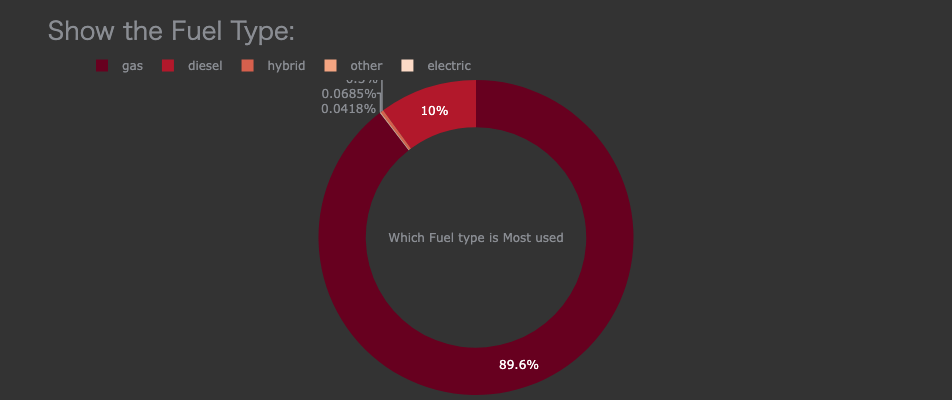

In [19]:
fig=go.Figure(data=[go.Pie(labels=fuel["fuel"],
                          values=fuel["count"],
                          hole=.7,
                          title="Which Fuel type is Most used",
                          marker_colors=px.colors.sequential.RdBu,)])
fig.update_layout(title="Show the Fuel Type:")

fig.update_xaxes(showgrid=False)

fig.update_yaxes(showgrid=False, categoryorder='total ascending', ticksuffix=' ', showline=False)

fig.update_traces(hovertemplate=None, marker=dict(line=dict(width=0)))

fig.update_layout(margin=dict(t=80, b=0, l=70, r=40),hovermode="y unified",
                  xaxis_title=' ', yaxis_title=" ", height=400,plot_bgcolor='#333', paper_bgcolor='#333',
title_font=dict(size=25, color='#8a8d93', family="Lato, sans-serif"),
 font=dict(color='#8a8d93'),
                  legend=dict(orientation="h", yanchor="bottom", y=1, xanchor="right", x=0.5),
                  hoverlabel=dict(bgcolor="black", font_size=13, font_family="Lato, sans-serif"))
                 


fig.show()

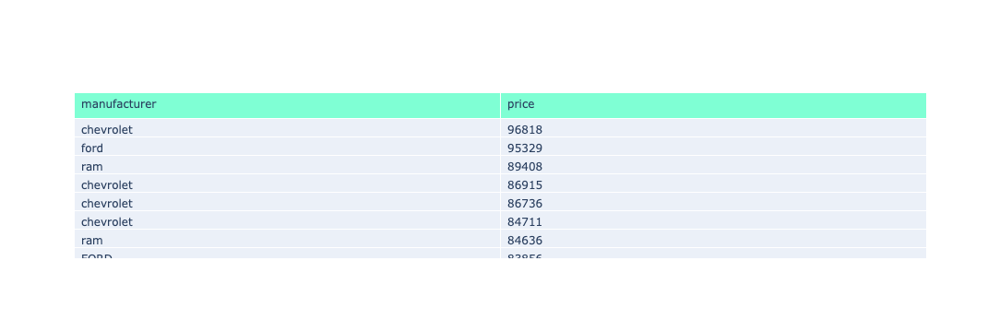

In [26]:
n=df_train[["price","manufacturer"]].sort_values(by="price",ascending=False).head(20)

con=n["manufacturer"]
p=n["price"]

go_fig = go.Figure()

obj = go.Table(
    header = dict(values=["manufacturer", "price"],
                 fill_color = 'aquamarine',
                 align = 'left'),
    cells = dict(values=[con, p],
                 align = 'left'))
go_fig.add_trace(obj)
go_fig.show()

In [27]:
location=pd.DataFrame(df_train["state"].value_counts().sort_values(ascending=False).reset_index())
location

,state,count
0,ca,3018
1,ny,2109
2,fl,1900
3,nj,1597
4,tx,1436
5,pa,1093
6,oh,964
7,va,851
8,mi,848
9,co,804


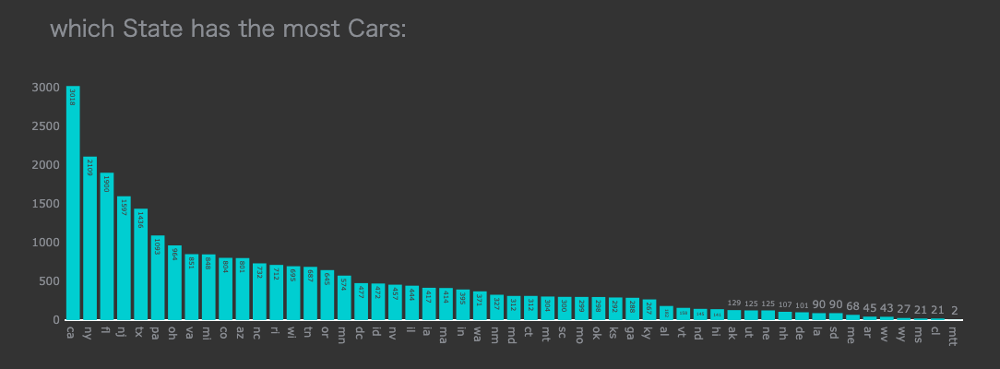

In [30]:
fig=px.bar(location,x="state",y="count",title="which State has the most Cars:",
          color_discrete_sequence=['darkturquoise'],text="count")

fig.update_xaxes(showgrid=False)

fig.update_yaxes(showgrid=False, categoryorder='total ascending', ticksuffix=' ', showline=False)

fig.update_traces(hovertemplate=None, marker=dict(line=dict(width=0)))

fig.update_layout(margin=dict(t=80, b=0, l=70, r=40),hovermode="y unified",
                  xaxis_title=' ', yaxis_title=" ", height=400,plot_bgcolor='#333', paper_bgcolor='#333',
title_font=dict(size=25, color='#8a8d93', family="Lato, sans-serif"),
 font=dict(color='#8a8d93'),
                  legend=dict(orientation="h", yanchor="bottom", y=1, xanchor="right", x=0.5),
                  hoverlabel=dict(bgcolor="black", font_size=13, font_family="Lato, sans-serif"))
                 

fig.show()

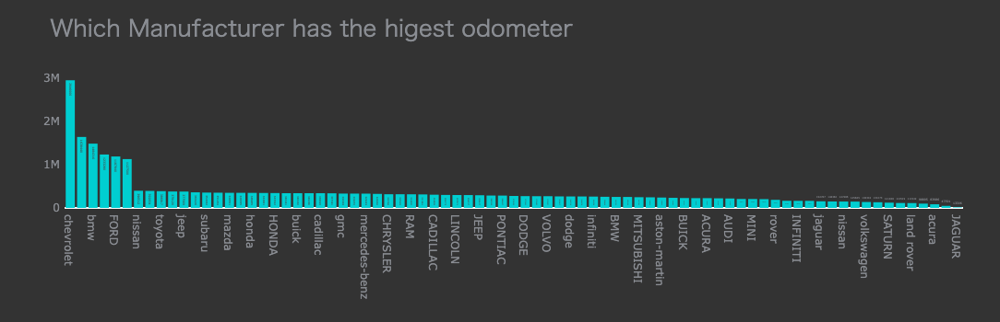

In [32]:
mileage=df_train.groupby(["manufacturer"])["odometer"].max().sort_values(ascending=False).reset_index()

fig=px.bar(mileage,x="manufacturer",y="odometer",title="Which Manufacturer has the higest odometer",text="odometer",color_discrete_sequence=["darkturquoise"])
fig.update_xaxes(showgrid=False)

fig.update_yaxes(showgrid=False, categoryorder='total ascending', ticksuffix=' ', showline=False)

fig.update_traces(hovertemplate=None, marker=dict(line=dict(width=0)))

fig.update_layout(margin=dict(t=80, b=0, l=70, r=40),hovermode="y unified",
                  xaxis_title=' ', yaxis_title=" ", height=350,plot_bgcolor='#333', paper_bgcolor='#333',
title_font=dict(size=25, color='#8a8d93', family="Lato, sans-serif"),
 font=dict(color='#8a8d93'),
                  legend=dict(orientation="h", yanchor="bottom", y=1, xanchor="right", x=0.5),
                  hoverlabel=dict(bgcolor="black", font_size=13, font_family="Lato, sans-serif"))
                 
                  

fig.show()

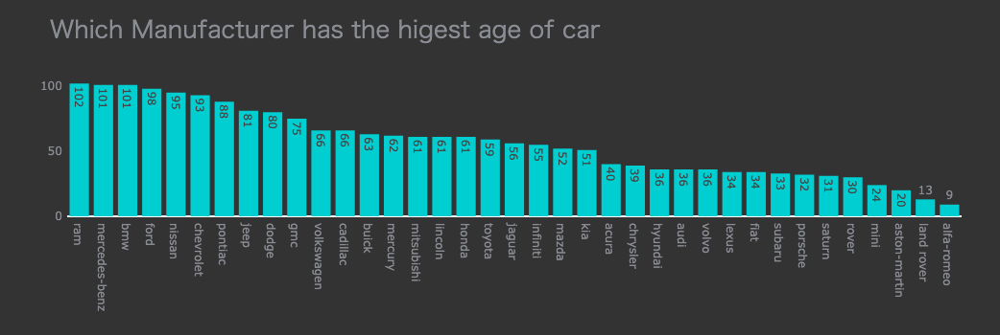

In [71]:
this_year=int(datetime.now().strftime("%Y"))

df_ageofcar=df_train
df_ageofcar['age_of_car']=this_year-df_ageofcar['year']
mileage=df_train.groupby(["manufacturer"])["age_of_car"].max().sort_values(ascending=False).reset_index()

fig=px.bar(mileage,x="manufacturer",y="age_of_car",title="Which Manufacturer has the higest age of car",text="age_of_car",color_discrete_sequence=["darkturquoise"])
fig.update_xaxes(showgrid=False)

fig.update_yaxes(showgrid=False, categoryorder='total ascending', ticksuffix=' ', showline=False)

fig.update_traces(hovertemplate=None, marker=dict(line=dict(width=0)))

fig.update_layout(margin=dict(t=80, b=0, l=70, r=40),hovermode="y unified",
                  xaxis_title=' ', yaxis_title=" ", height=350,plot_bgcolor='#333', paper_bgcolor='#333',
title_font=dict(size=25, color='#8a8d93', family="Lato, sans-serif"),
 font=dict(color='#8a8d93'),
                  legend=dict(orientation="h", yanchor="bottom", y=1, xanchor="right", x=0.5),
                  hoverlabel=dict(bgcolor="black", font_size=13, font_family="Lato, sans-serif"))
                 
                  

fig.show()

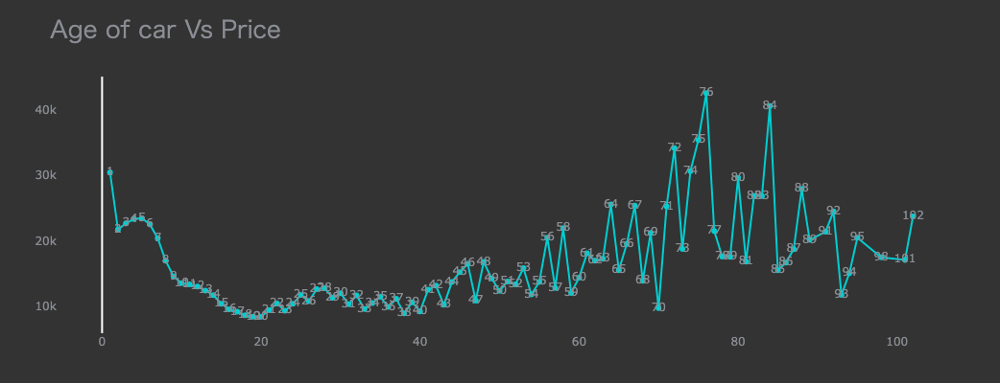

In [55]:
age=pd.pivot_table(df_ageofcar,index=["age_of_car"],values=["price"])

age=pd.DataFrame(age).sort_values(by="age_of_car",ascending=False).reset_index()

fig=px.line(age,x="age_of_car",y="price",title="Age of car Vs Price",text="age_of_car",
           color_discrete_sequence=["darkturquoise"])

fig.update_xaxes(showgrid=False)

fig.update_yaxes(showgrid=False, categoryorder='total ascending', ticksuffix=' ', showline=False)

fig.update_traces(hovertemplate=None, marker=dict(line=dict(width=0)))

fig.update_layout(margin=dict(t=80, b=40, l=30, r=40),hovermode="y unified",
                  xaxis_title=' ', yaxis_title=" ", height=400,plot_bgcolor='#333', paper_bgcolor='#333',
title_font=dict(size=25, color='#8a8d93', family="Lato, sans-serif"),
 font=dict(color='#8a8d93'),
                  legend=dict(orientation="h", yanchor="bottom", y=1, xanchor="right", x=0.5),
                  hoverlabel=dict(bgcolor="black", font_size=14, font_family="Lato, sans-serif"))

fig.show()

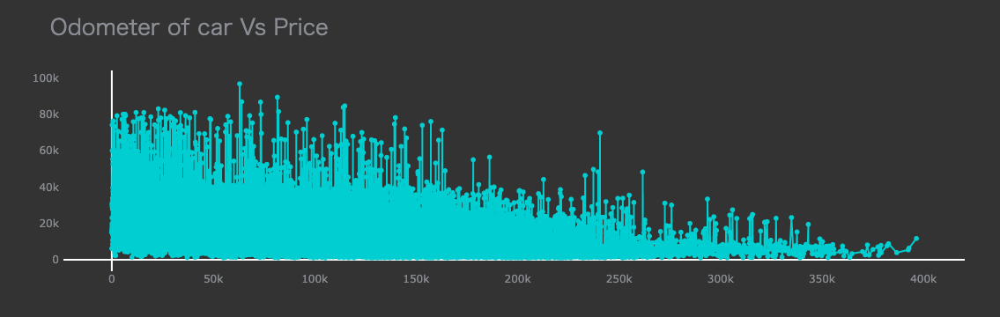

In [72]:
age=pd.pivot_table(df_ageofcar,index=["odometer"],values=["price"])

age=pd.DataFrame(age).sort_values(by="odometer",ascending=False).reset_index()

fig=px.line(age,x="odometer",y="price",title="Odometer of car Vs Price",text="odometer",
           color_discrete_sequence=["darkturquoise"])

fig.update_xaxes(showgrid=False)

fig.update_yaxes(showgrid=False, categoryorder='total ascending', ticksuffix=' ', showline=False)

fig.update_traces(hovertemplate=None, marker=dict(line=dict(width=0)))

fig.update_layout(margin=dict(t=80, b=40, l=30, r=40),hovermode="y unified",
                  xaxis_title=' ', yaxis_title=" ", height=400,plot_bgcolor='#333', paper_bgcolor='#333',
title_font=dict(size=25, color='#8a8d93', family="Lato, sans-serif"),
 font=dict(color='#8a8d93'),
                  legend=dict(orientation="h", yanchor="bottom", y=1, xanchor="right", x=0.5),
                  hoverlabel=dict(bgcolor="black", font_size=14, font_family="Lato, sans-serif"))

fig.show()

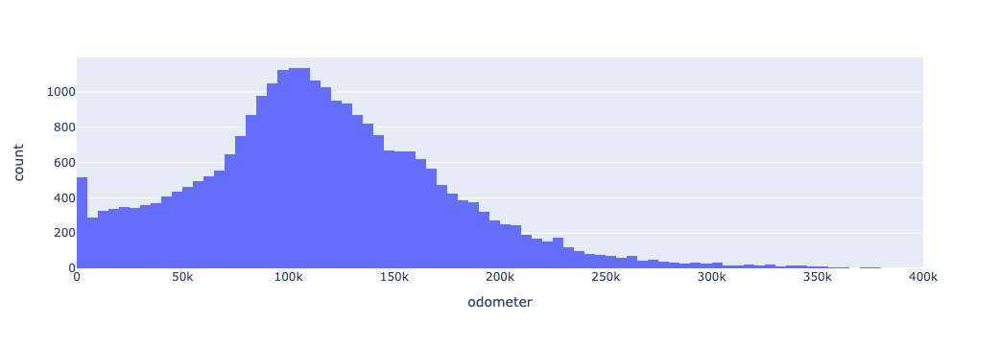

In [73]:
px.histogram(df_train, x='odometer')


In [76]:
# 走行距離が5０万キロ超えているのはちょっとありえない
df_train[df_train['odometer']>500000]

,id,region,year,manufacturer,condition,cylinders,fuel,odometer,title_status,transmission,drive,size,type,paint_color,price,state,age_of_car


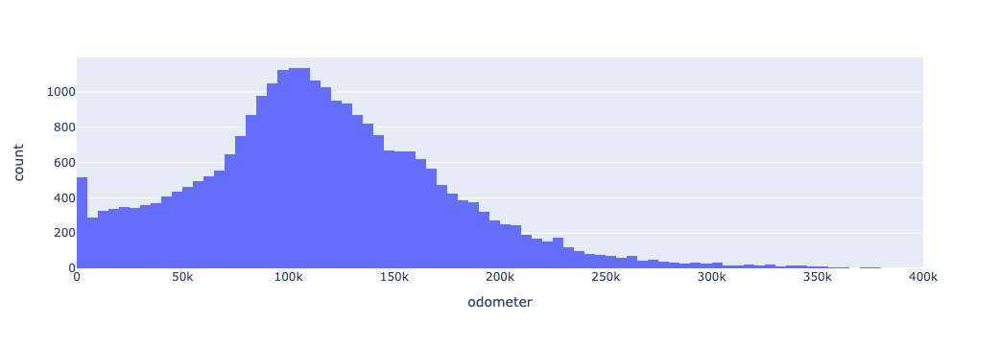

In [74]:
px.histogram(df_test, x='odometer')

In [75]:
# 走行距離が5０万キロ超えているのはちょっとありえない
df_test[df_test['odometer']>500000]

,id,region,year,manufacturer,condition,cylinders,fuel,odometer,title_status,transmission,drive,size,type,paint_color,price,state


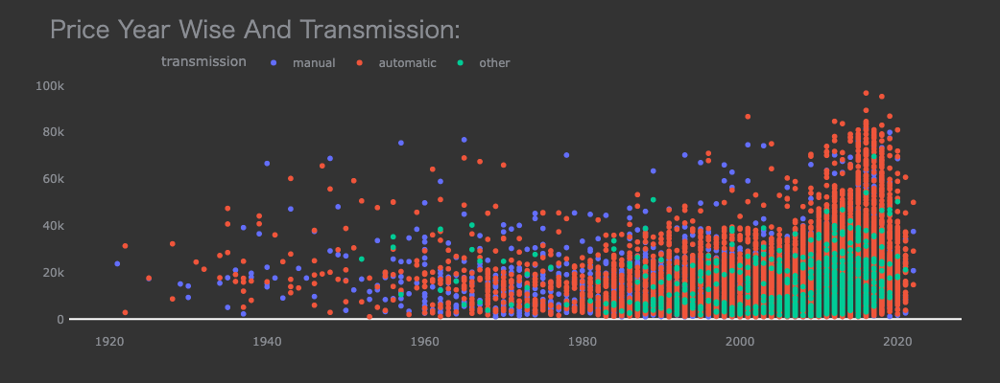

In [77]:
fig=px.scatter(df_train,x="year",y='price',color="transmission",title="Price Year Wise And Transmission:")

fig.update_xaxes(showgrid=False)

fig.update_yaxes(showgrid=False, categoryorder='total ascending', ticksuffix=' ', showline=False)

fig.update_traces(hovertemplate=None, marker=dict(line=dict(width=0)))

fig.update_layout(margin=dict(t=80, b=40, l=30, r=40),hovermode="y unified",
                  xaxis_title=' ', yaxis_title=" ", height=400,plot_bgcolor='#333', paper_bgcolor='#333',
title_font=dict(size=25, color='#8a8d93', family="Lato, sans-serif"),
 font=dict(color='#8a8d93'),
                  legend=dict(orientation="h", yanchor="bottom", y=1, xanchor="right", x=0.5),
                  hoverlabel=dict(bgcolor="black", font_size=14, font_family="Lato, sans-serif"))

fig.show()

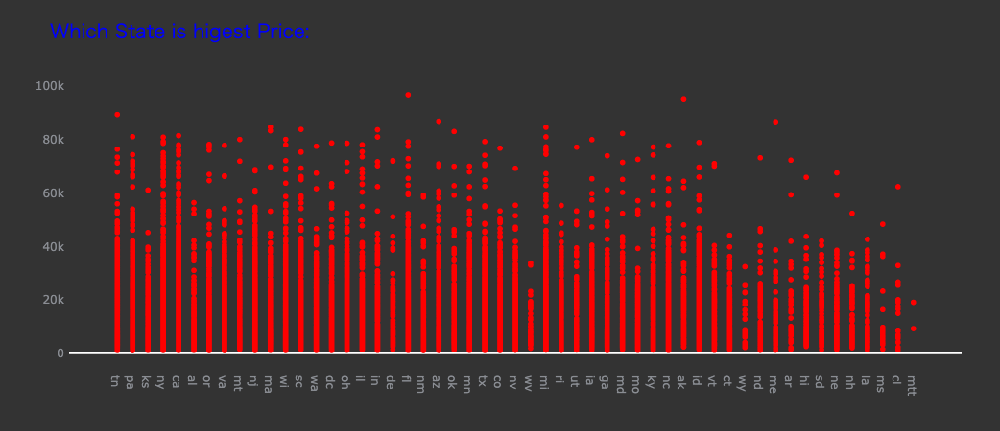

In [78]:
fig=px.scatter(df_train,x="state",y="price",title="Which State is higest Price:",color_discrete_sequence=["red"])
fig.update_xaxes(showgrid=False)

fig.update_yaxes(showgrid=False, categoryorder='total ascending', ticksuffix=' ', showline=False)

fig.update_traces(hovertemplate=None, marker=dict(line=dict(width=0)))

fig.update_layout(margin=dict(t=80, b=40, l=30, r=40),hovermode="y unified",
                  xaxis_title=' ', yaxis_title=" ", height=450,plot_bgcolor='#333', paper_bgcolor='#333',
title_font=dict(size=20, color='blue', family="Lato, sans-serif"),
 font=dict(color='#8a8d93'),
                  legend=dict(orientation="h", yanchor="bottom", y=1, xanchor="right", x=0.5),
                  hoverlabel=dict(bgcolor="black", font_size=14, font_family="Lato, sans-serif"))


fig.show()

In [81]:
df_train[df_train["condition"]=='new']

,id,region,year,manufacturer,condition,cylinders,fuel,odometer,title_status,transmission,drive,size,type,paint_color,price,state,age_of_car
156,156,wyoming,2008,toyota,new,6 cylinders,gas,174860,clean,manual,fwd,full-size,truck,silver,22855,wy,15
1032,1032,pittsburgh,2016,ford,new,6 cylinders,gas,26592,clean,automatic,fwd,mid-size,sedan,grey,23063,pa,7
1494,1494,champaign urbana,1985,ford,new,4 cylinders,gas,133381,clean,automatic,fwd,full-size,other,green,12925,il,38
1565,1565,inland empire,2002,ford,new,8 cylinders,gas,73673,clean,automatic,rwd,compact,coupe,black,6851,ca,21
1577,1577,binghamton,2015,hyundai,new,4 cylinders,gas,62828,clean,automatic,fwd,full-size,hatchback,black,5809,ny,8
2218,2218,mohave county,2021,ford,new,6 cylinders,diesel,843,clean,automatic,4wd,full-size,SUV,black,60771,az,2
2538,2538,dayton / springfield,2020,honda,new,4 cylinders,gas,10286,clean,automatic,fwd,mid-size,SUV,blue,9392,oh,3
3114,3114,milwaukee,1972,dodge,new,4 cylinders,gas,31698,clean,automatic,rwd,mid-size,sedan,black,7821,wi,51
3145,3145,bakersfield,1990,chevrolet,new,6 cylinders,gas,82605,clean,manual,fwd,full-size,sedan,red,13342,ca,33
3835,3835,dallas / fort worth,2011,honda,new,4 cylinders,gas,22436,salvage,manual,fwd,compact,sedan,black,6418,tx,12


In [94]:
aa=df_train['paint_color'].unique()
aa

array(['orange', 'silver', 'blue', 'red', 'black', 'white', 'green',
       'brown', 'grey', 'purple', 'custom', 'yellow'], dtype=object)

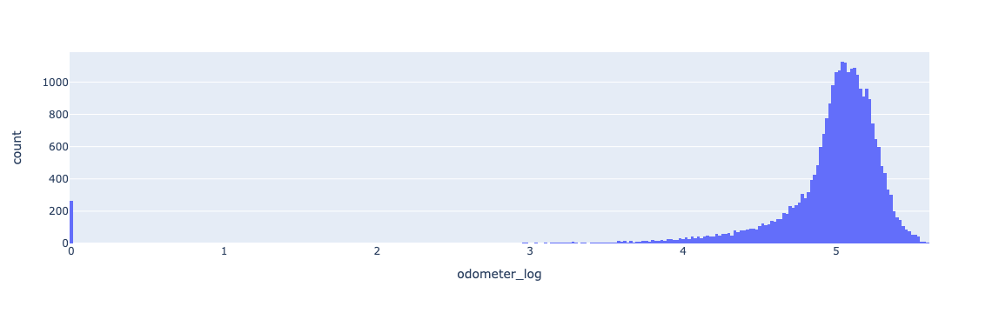

In [95]:
df_odolog=df_train
df_odolog['odometer_log']=np.log10(df_odolog['odometer'])
px.histogram(df_odolog, x='odometer_log')


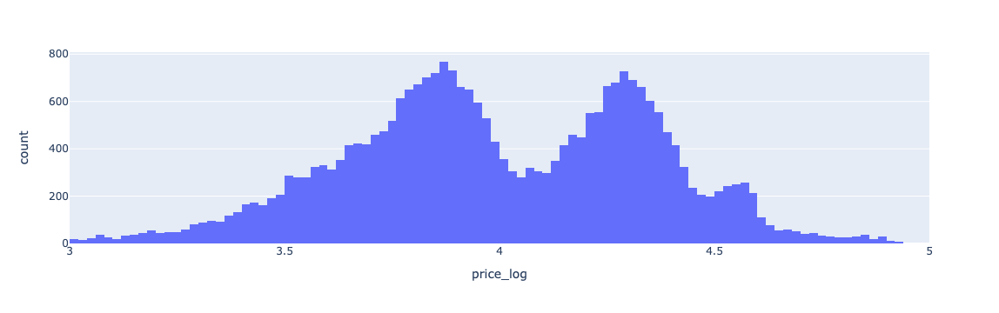

In [96]:
df_pricelog=df_train
df_pricelog['price_log']=np.log10(df_pricelog['price'])
px.histogram(df_pricelog, x='price_log')


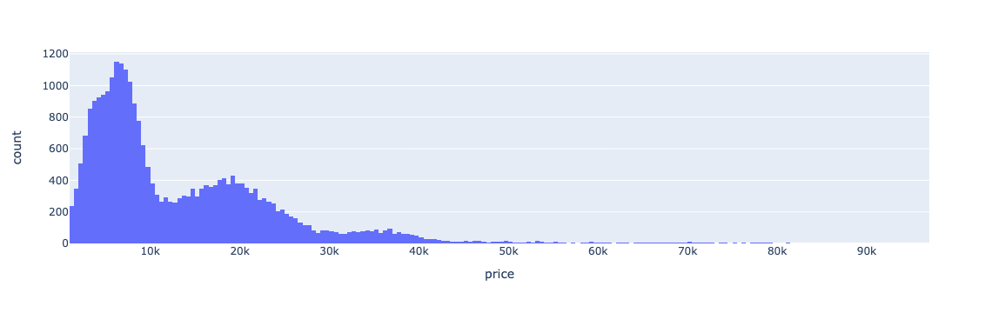

In [97]:
px.histogram(df_train, x='price')

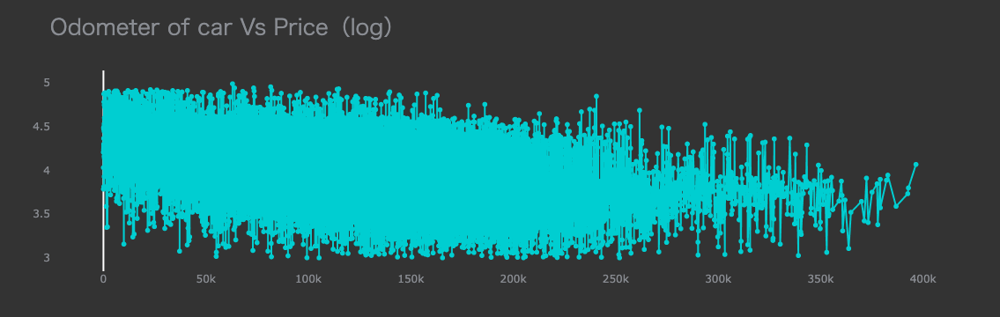

In [98]:
age=pd.pivot_table(df_pricelog,index=["odometer"],values=["price_log"])

age=pd.DataFrame(age).sort_values(by="odometer",ascending=False).reset_index()

fig=px.line(age,x="odometer",y="price_log",title="Odometer of car Vs Price（log）",text="odometer",
           color_discrete_sequence=["darkturquoise"])

fig.update_xaxes(showgrid=False)

fig.update_yaxes(showgrid=False, categoryorder='total ascending', ticksuffix=' ', showline=False)

fig.update_traces(hovertemplate=None, marker=dict(line=dict(width=0)))

fig.update_layout(margin=dict(t=80, b=40, l=30, r=40),hovermode="y unified",
                  xaxis_title=' ', yaxis_title=" ", height=400,plot_bgcolor='#333', paper_bgcolor='#333',
title_font=dict(size=25, color='#8a8d93', family="Lato, sans-serif"),
 font=dict(color='#8a8d93'),
                  legend=dict(orientation="h", yanchor="bottom", y=1, xanchor="right", x=0.5),
                  hoverlabel=dict(bgcolor="black", font_size=14, font_family="Lato, sans-serif"))

fig.show()

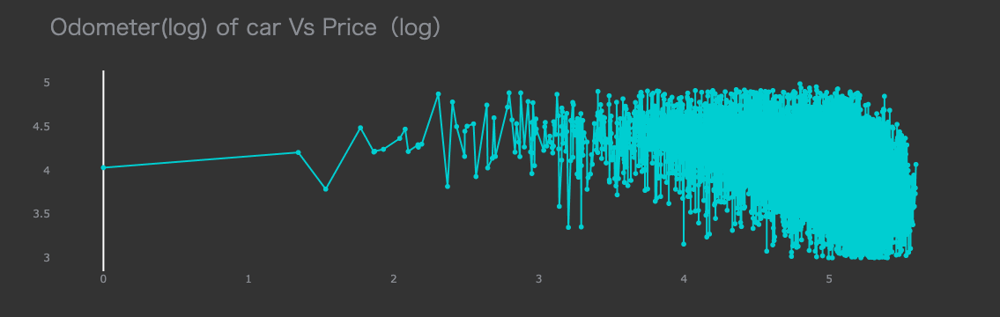

In [99]:
df_pricelog['odometer_log']=np.log10(df_odolog['odometer'])


age=pd.pivot_table(df_pricelog,index=["odometer_log"],values=["price_log"])

age=pd.DataFrame(age).sort_values(by="odometer_log",ascending=False).reset_index()

fig=px.line(age,x="odometer_log",y="price_log",title="Odometer(log) of car Vs Price（log）",text="odometer_log",
           color_discrete_sequence=["darkturquoise"])

fig.update_xaxes(showgrid=False)

fig.update_yaxes(showgrid=False, categoryorder='total ascending', ticksuffix=' ', showline=False)

fig.update_traces(hovertemplate=None, marker=dict(line=dict(width=0)))

fig.update_layout(margin=dict(t=80, b=40, l=30, r=40),hovermode="y unified",
                  xaxis_title=' ', yaxis_title=" ", height=400,plot_bgcolor='#333', paper_bgcolor='#333',
title_font=dict(size=25, color='#8a8d93', family="Lato, sans-serif"),
 font=dict(color='#8a8d93'),
                  legend=dict(orientation="h", yanchor="bottom", y=1, xanchor="right", x=0.5),
                  hoverlabel=dict(bgcolor="black", font_size=14, font_family="Lato, sans-serif"))

fig.show()

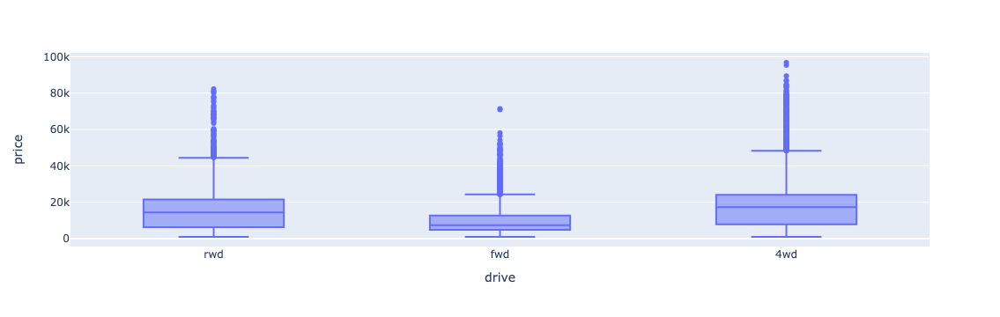

In [101]:
px.box(df_train, y='price', x='drive')

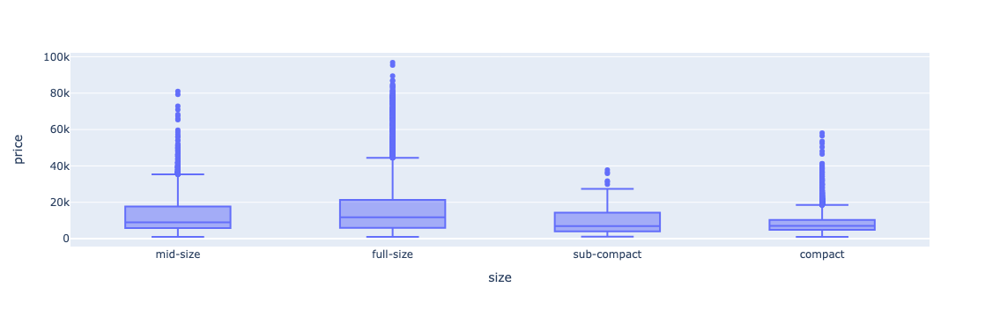

In [102]:
px.box(df_train, y='price', x='size')

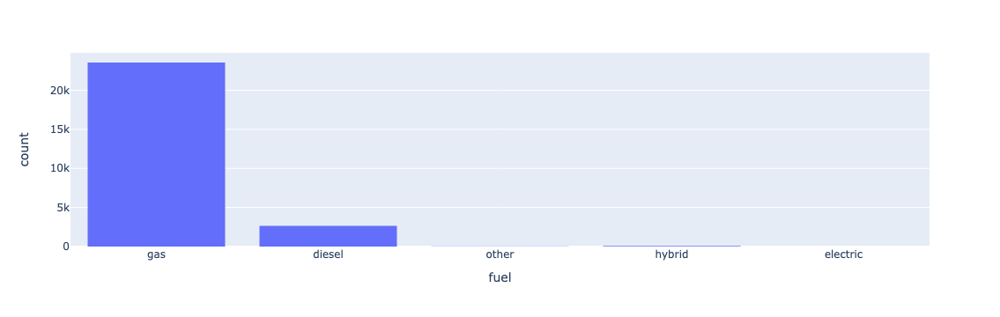

In [103]:
px.histogram(df_train, x="fuel")

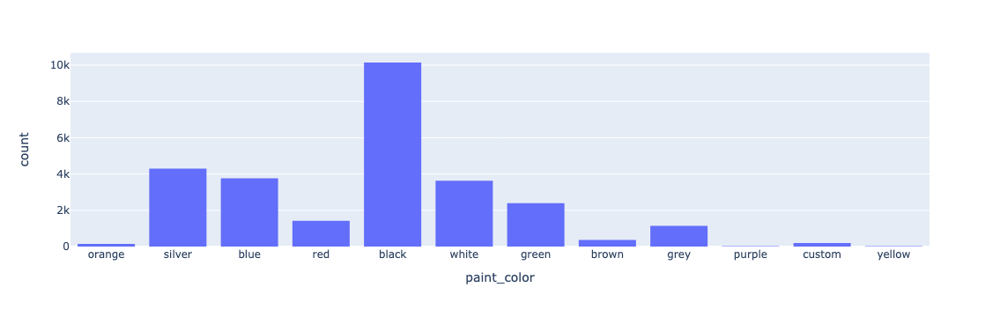

In [104]:
px.histogram(df_train, x="paint_color")

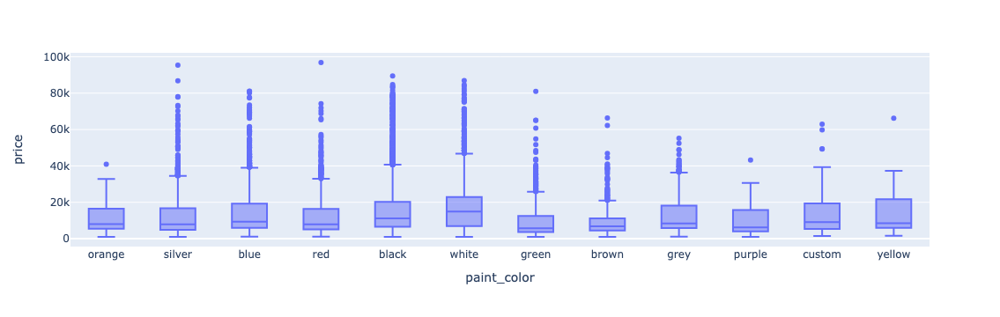

In [105]:
px.box(df_train, y='price', x='paint_color')

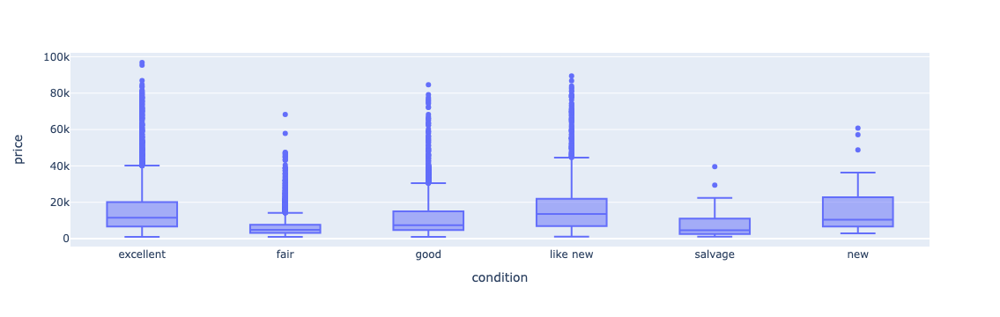

In [106]:
px.box(df_train, y='price', x='condition')

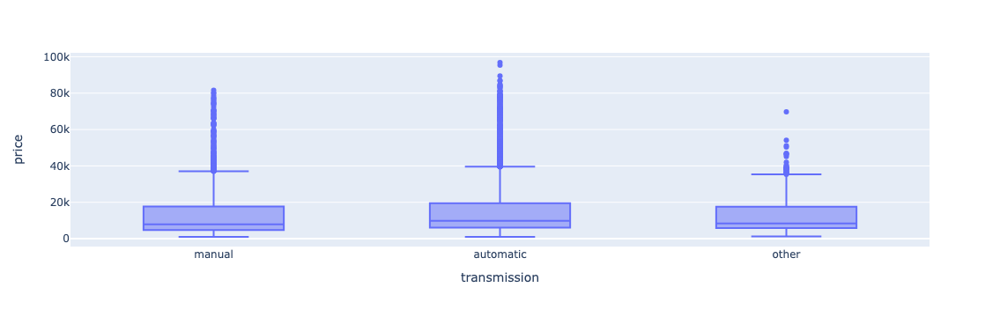

In [107]:
px.box(df_train, y='price', x='transmission')

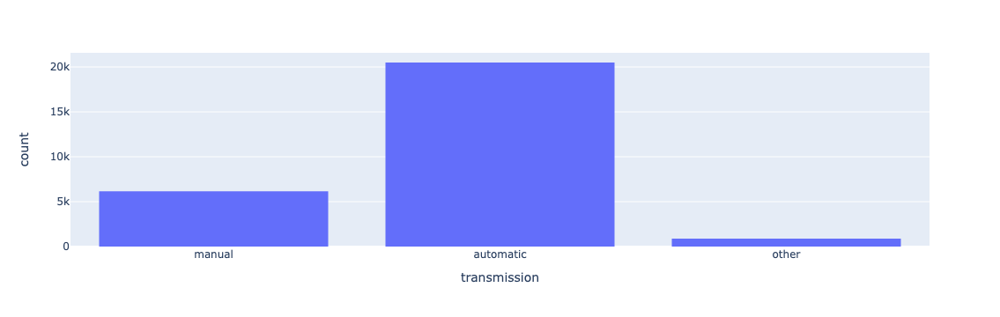

In [108]:
px.histogram(df_train, x="transmission")